In [1]:
from PIL import Image

from typing import List
import numpy as np
import torch
from fastai.tabular.all import *
import pandas as pd
import glob


/Users/emil/mambaforge/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [30]:
from mmpose.apis import inference_top_down_pose_model, init_pose_model, process_mmdet_results
from mmdet.apis import inference_detector, init_detector

def create_pose_model(device: torch.device):
  pose_config = 'mmcv-configs/pose.py'
  pose_checkpoint = 'https://download.openmmlab.com/mmpose/top_down/resnet/res50_coco_256x192-ec54d7f3_20200709.pth'
  pose_model = init_pose_model(pose_config, pose_checkpoint, device=device if device.type != 'mps' else None)
  return pose_model


def get_poses(image: Image, pose_model) -> List[dict]:
  pose_results, _ = inference_top_down_pose_model(pose_model, np.asarray(image))

  poses = []
  for pose_result in pose_results:
    keypoints = {}
    for index, point in enumerate(pose_result['keypoints']):
      keypoint_name = pose_model.cfg.dataset_info.keypoint_info[index].name
      keypoints[keypoint_name + "_x"] = np.float32(point[0])
      keypoints[keypoint_name + "_y"] = np.float32( point[1])
    poses.append(keypoints)

  return poses[0]

d = torch.device("cpu")
pose_model = create_pose_model(d)
print("done!")

load checkpoint from http path: https://download.openmmlab.com/mmpose/top_down/resnet/res50_coco_256x192-ec54d7f3_20200709.pth
done!


In [31]:
# open all imags in the dataset/good folder
imgs = [Image.open(f) for f in glob.glob("dataset/good/*.jpg")]
goodposes = [get_poses(img, pose_model) for img in imgs]
imgs = [Image.open(f) for f in glob.glob("dataset/bad/*.jpg")]
badposes = [get_poses(img, pose_model) for img in imgs]


# create a dataframe with the keypoints
df = pd.DataFrame(goodposes)
df['label'] = 1
df2 = pd.DataFrame(badposes)
df2['label'] = 0
df = df.append(df2)
df = df.fillna(0)

cols = list(df.columns)[:-1]
print(cols)

dls = TabularDataLoaders.from_df(df, path='.',
    cat_names=[],
    cont_names=cols,
    y_block = CategoryBlock,
    y_names='label',
    procs=[Categorify, FillMissing, Normalize],
    bs=8
)

['nose_x', 'nose_y', 'left_eye_x', 'left_eye_y', 'right_eye_x', 'right_eye_y', 'left_ear_x', 'left_ear_y', 'right_ear_x', 'right_ear_y', 'left_shoulder_x', 'left_shoulder_y', 'right_shoulder_x', 'right_shoulder_y', 'left_elbow_x', 'left_elbow_y', 'right_elbow_x', 'right_elbow_y', 'left_wrist_x', 'left_wrist_y', 'right_wrist_x', 'right_wrist_y', 'left_hip_x', 'left_hip_y', 'right_hip_x', 'right_hip_y', 'left_knee_x', 'left_knee_y', 'right_knee_x', 'right_knee_y', 'left_ankle_x', 'left_ankle_y', 'right_ankle_x', 'right_ankle_y']


/var/folders/m2/j9fn_rlj32scr49sb_psxlnr0000gp/T/ipykernel_17333/1340978253.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2)


epoch,train_loss,valid_loss,accuracy,time
0,0.737591,0.645572,0.692308,00:00
1,0.704124,0.626540,0.692308,00:00
2,0.654984,0.603312,0.692308,00:00
3,0.598717,0.591509,0.769231,00:00
4,0.560244,0.548832,0.769231,00:00


In [34]:
learn = tabular_learner(dls, metrics=accuracy)
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,time
0,0.722418,0.747612,0.307692,00:00
1,0.690531,0.714866,0.384615,00:00
2,0.628960,0.656538,0.615385,00:00
3,0.590341,0.684351,0.692308,00:00
4,0.546733,0.579167,0.692308,00:00
5,0.542055,0.508756,0.846154,00:00
6,0.519610,0.491805,0.923077,00:00
7,0.494378,0.434490,0.923077,00:00
8,0.482027,0.389010,0.923077,00:00
9,0.476799,0.375552,0.923077,00:00


In [35]:
print(dls)

dls.show_batch()

,nose_x,nose_y,left_eye_x,left_eye_y,right_eye_x,right_eye_y,left_ear_x,left_ear_y,right_ear_x,right_ear_y,left_shoulder_x,left_shoulder_y,right_shoulder_x,right_shoulder_y,left_elbow_x,left_elbow_y,right_elbow_x,right_elbow_y,left_wrist_x,left_wrist_y,right_wrist_x,right_wrist_y,left_hip_x,left_hip_y,right_hip_x,right_hip_y,left_knee_x,left_knee_y,right_knee_x,right_knee_y,left_ankle_x,left_ankle_y,right_ankle_x,right_ankle_y,label
0,331.731750,117.669243,341.236938,98.658806,322.226562,98.658813,360.247375,108.164070,312.721313,108.164062,379.257812,165.195312,293.710938,165.195312,407.773438,203.216125,255.690063,222.226562,398.268188,212.721375,293.710938,260.247375,360.247375,260.247375,303.216125,260.247375,379.257812,307.773438,293.710938,298.268250,379.257812,326.783875,312.721313,364.804688,0
1,201.239258,79.573242,216.444336,64.368164,186.034180,69.436523,236.717773,79.573242,165.760742,84.641602,267.127930,170.803711,125.213867,165.735352,343.153320,251.897461,33.983414,241.760742,282.333008,332.991211,94.803711,332.991211,231.649414,398.879883,145.487305,393.811523,221.512695,520.520508,125.213867,520.520508,196.170898,500.247070,104.940430,500.247070,0
2,290.999969,107.000061,310.999969,87.000061,270.999969,87.000061,340.999969,97.000061,241.000031,107.000061,380.999969,197.000061,201.000031,207.000061,420.999969,297.000061,71.000031,287.000061,380.999969,427.000061,161.000031,417.000061,350.999969,507.000061,231.000031,497.000061,330.999969,707.000061,231.000031,717.000061,300.999969,876.999939,241.000031,936.999939,0
3,664.000122,610.666748,664.000122,610.666748,690.666626,610.666748,664.000122,637.333252,637.333374,610.666748,584.000122,717.333252,557.333374,690.666748,477.333374,477.333252,504.000122,424.000000,690.666626,717.333252,530.666626,210.666626,530.666626,1010.666748,477.333374,984.000000,637.333374,1197.333252,637.333374,1277.333252,450.666748,1490.666748,557.333374,1597.333252,0
4,343.359375,185.296875,374.765625,153.890625,322.421875,153.890625,437.578125,164.359375,301.484375,164.359375,531.796875,331.859375,249.140625,342.328125,678.359375,509.828125,133.984375,499.359375,584.140625,666.859375,217.734375,656.390625,479.453125,771.546875,301.484375,771.546875,552.734375,1064.671875,249.140625,1054.203125,510.859375,1001.859375,249.140625,1012.328125,0
5,383.285156,237.402344,408.675781,186.621094,345.199219,212.011719,484.847656,199.316406,319.808594,237.402344,599.105469,427.832031,345.199219,427.832031,764.144531,694.433594,281.722656,618.261719,611.800781,897.558594,243.636719,783.300781,459.457031,961.035156,281.722656,948.339844,459.457031,1291.113281,319.808594,1278.417969,522.933594,1227.636719,332.503906,1253.027344,0
6,370.589844,148.535156,395.980469,135.839844,357.894531,135.839844,434.066406,135.839844,332.503906,148.535156,484.847656,250.097656,307.113281,288.183594,624.496094,377.050781,294.417969,465.917969,548.324219,516.699219,256.332031,643.652344,459.457031,580.175781,345.199219,580.175781,497.542969,872.167969,370.589844,846.777344,345.199219,1075.292969,395.980469,1138.769531,1
7,296.093750,202.343750,288.281250,194.531250,280.468750,202.343750,288.281250,202.343750,272.656250,210.156250,303.906250,241.406250,288.281250,249.218750,303.906250,163.281250,296.093750,163.281250,303.906250,92.968750,296.093750,92.968750,319.531250,382.031250,303.906250,382.031250,428.906250,421.093750,202.343750,467.968750,428.906250,530.468750,124.218750,530.468750,0


/Users/emil/mambaforge/lib/python3.10/site-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'JpegImageFile' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'JpegImageFile', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



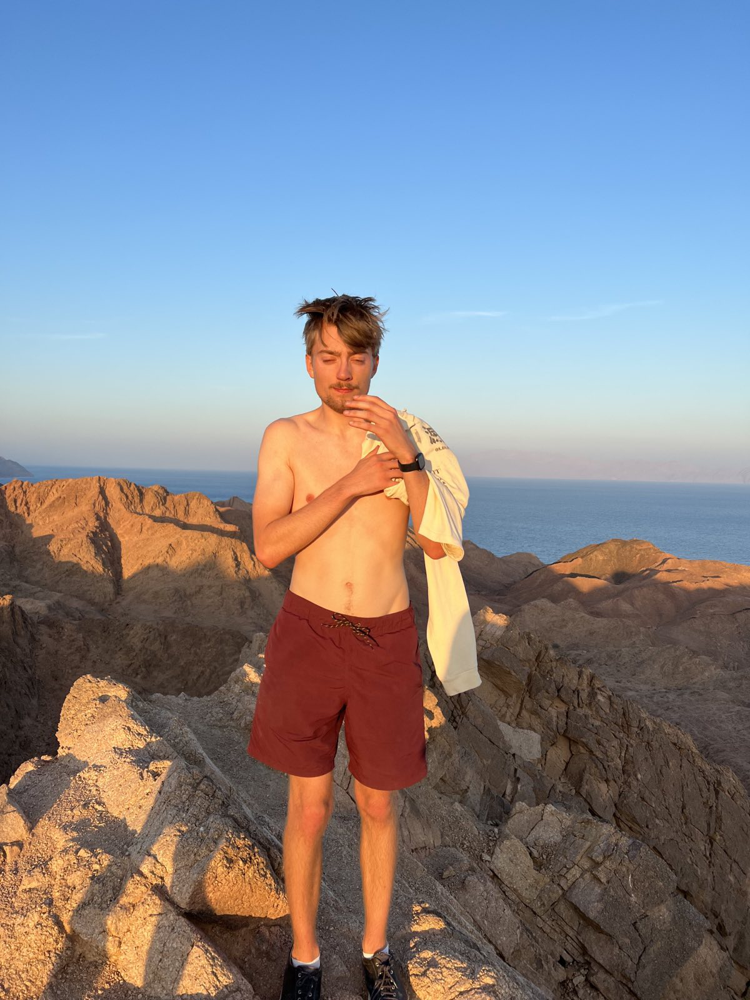
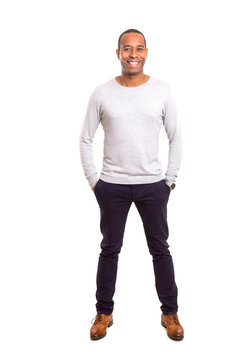


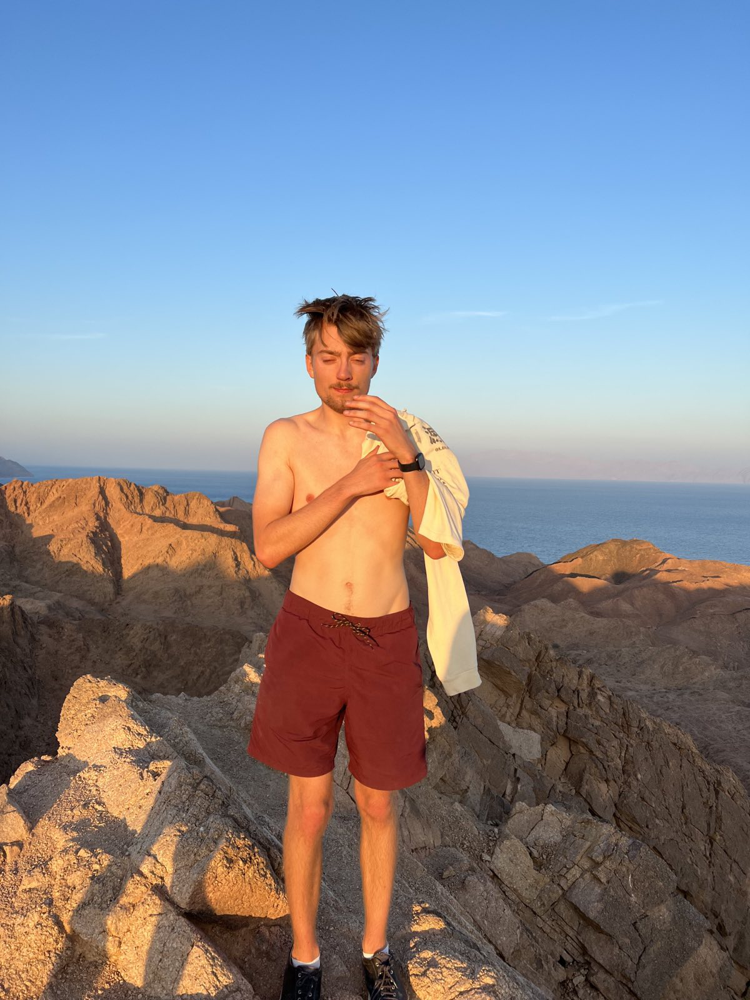
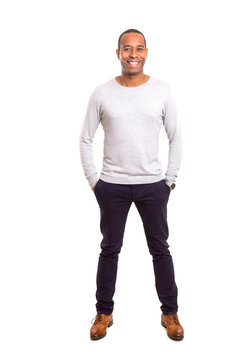


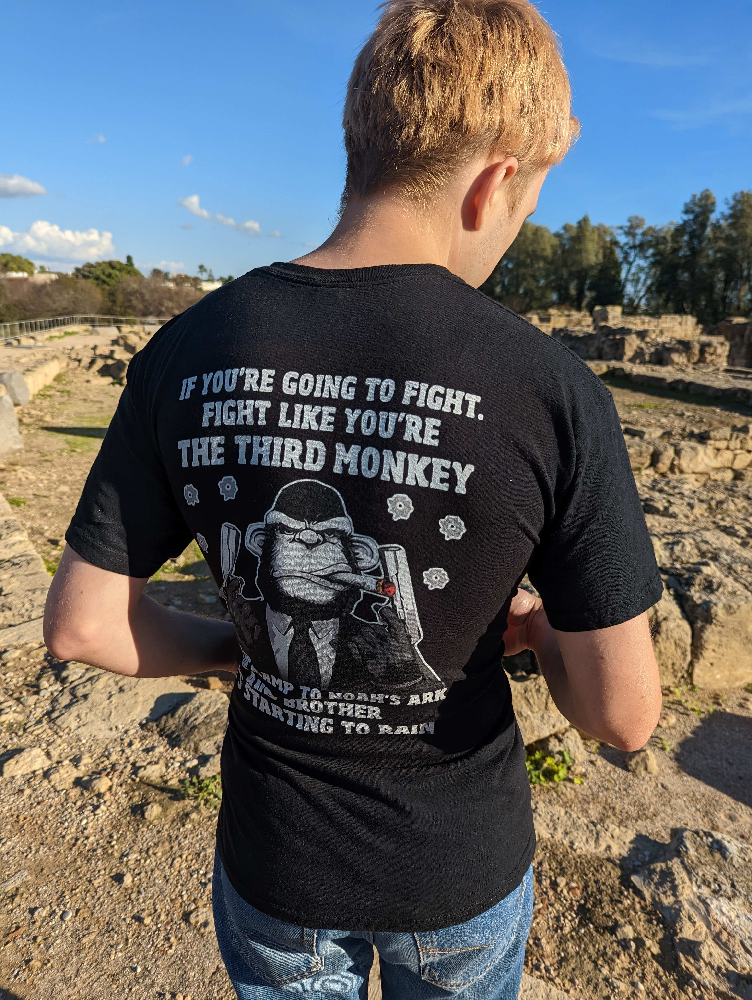
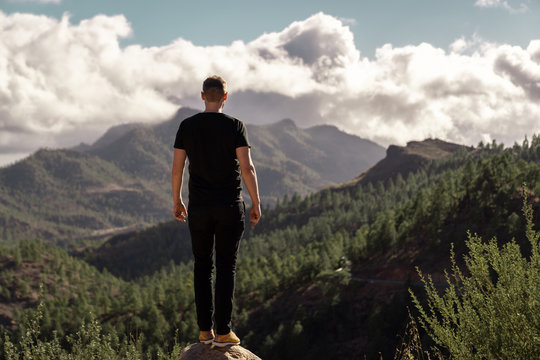


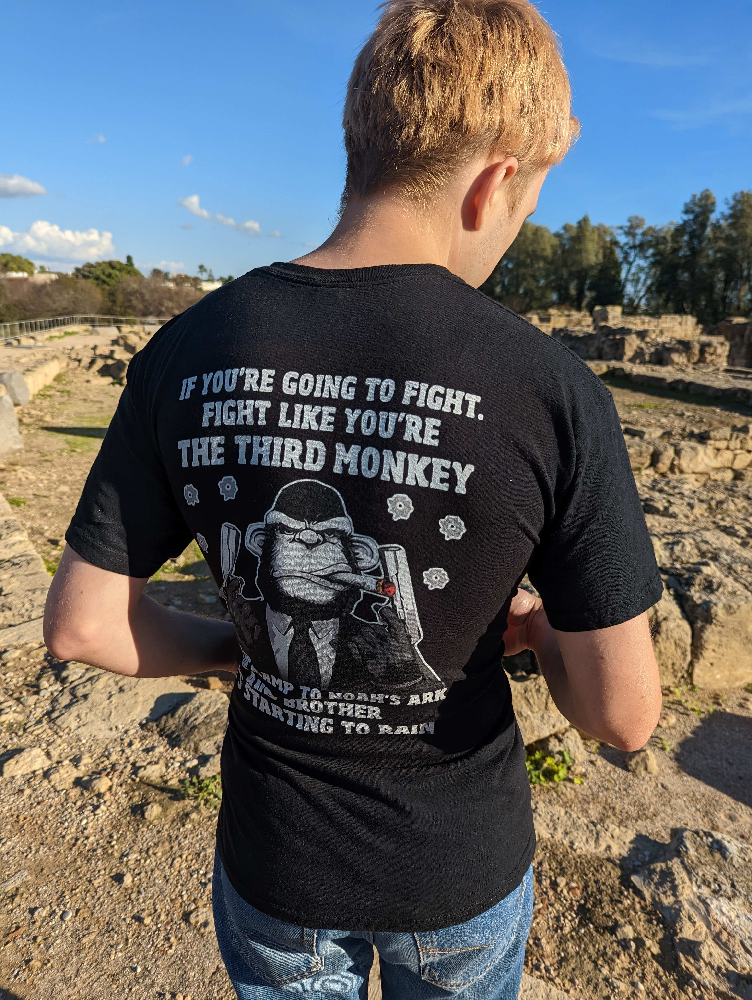
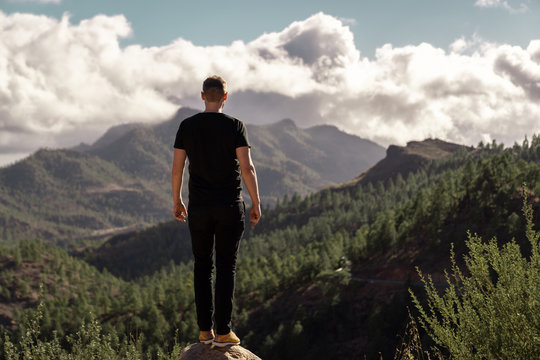

In [36]:
good = [
    Image.open("poses/bad.jpeg"),
    Image.open("poses/goodman.jpg"),
]
bad = [
    Image.open("poses/wrongorient.jpg"),
    Image.open("poses/behind.jpg"),
]

import ipyplot

goodres = [learn.predict(pd.DataFrame([get_poses(img, pose_model)]).iloc[0]) for img in good]
badres = [learn.predict(pd.DataFrame([get_poses(img, pose_model)]).iloc[0]) for img in bad]
    
ipyplot.plot_images(good, [r[1] for r in goodres], img_width=300)
ipyplot.plot_images(bad, [r[1] for r in badres], img_width=300)